<a href="https://colab.research.google.com/github/TuanTony5/Pre-AIO-Warm-up-/blob/main/%5Bsolution%5D_Car_Detection_YOLOv8_Full.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 0. Download dataset

In [ ]:
# https://drive.google.com/file/d/1kdypEb7Q0NFSg0Ct7PeG0akVlnYxlhZp/view?usp=drive_link
!gdown 1kdypEb7Q0NFSg0Ct7PeG0akVlnYxlhZp

Downloading...
From: https://drive.google.com/uc?id=1kdypEb7Q0NFSg0Ct7PeG0akVlnYxlhZp
To: /content/car_object_detection.zip
100% 118M/118M [00:05<00:00, 23.5MB/s]


In [ ]:
!unzip car_object_detection.zip

## 1. Import libraries

In [ ]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.237 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.5/78.2 GB disk)


In [ ]:
import os
import shutil
import yaml
import numpy as np
import pandas as pd
import cv2
import json
import matplotlib.pyplot as plt

from ultralytics import YOLO
from PIL import Image
from sklearn.model_selection import train_test_split

## 2. Prepare YOLOv8 data

In [ ]:
train_data_dir = '/content/data/training_images'
label_filepath = '/content/data/train_solution_bounding_boxes (1).csv'
df = pd.read_csv(label_filepath)
df
# YOLO: x_center, y_center, width, height
# PascalVOC -> YOLO
# (x_min, y_min, x_max, y_max) -> (x_center, y_center, width, height)

,image,xmin,ymin,xmax,ymax
0,vid_4_1000.jpg,281.259045,187.035071,327.727931,223.225547
1,vid_4_10000.jpg,15.163531,187.035071,120.329957,236.430180
2,vid_4_10040.jpg,239.192475,176.764801,361.968162,236.430180
3,vid_4_10020.jpg,496.483358,172.363256,630.020260,231.539575
4,vid_4_10060.jpg,16.630970,186.546010,132.558611,238.386422
...,...,...,...,...,...
554,vid_4_9860.jpg,0.000000,198.321729,49.235251,236.223284
555,vid_4_9880.jpg,329.876184,156.482351,536.664239,250.497895
556,vid_4_9900.jpg,0.000000,168.295823,141.797524,239.176652
557,vid_4_9960.jpg,487.428988,172.233646,616.917699,228.839864


In [ ]:
train_data_dir = '/content/data/training_images'
label_filepath = '/content/data/train_solution_bounding_boxes (1).csv'
df = pd.read_csv(label_filepath)

pil_img = Image.open('/content/data/testing_images/vid_5_25100.jpg')
img_width, img_height = pil_img.size

df['class'] = 0
df.rename(columns={'image':'img_name'}, inplace=True)

df['x_center'] = (df['xmin'] + df['xmax']) / 2
df['y_center'] = (df['ymin'] + df['ymax']) / 2
df['bbox_w'] = df['xmax'] - df['xmin']
df['bbox_h'] = df['ymax'] - df['ymin']

df['x_center'] = df['x_center'] / img_width
df['y_center']= df['y_center'] / img_height
df['bbox_w'] = df['bbox_w'] / img_width
df['bbox_h'] = df['bbox_h'] / img_height

class_labels = ['car']
yolo_df = df[['img_name', 'class', 'x_center', 'y_center', 'bbox_w', 'bbox_h']]
yolo_df

,img_name,class,x_center,y_center,bbox_w,bbox_h
0,vid_4_1000.jpg,0,0.450434,0.539817,0.068741,0.095238
1,vid_4_10000.jpg,0,0.100217,0.557191,0.155572,0.129987
2,vid_4_10040.jpg,0,0.444645,0.543678,0.181621,0.157014
3,vid_4_10020.jpg,0,0.833213,0.531451,0.197540,0.155727
4,vid_4_10060.jpg,0,0.110347,0.559122,0.171491,0.136422
...,...,...,...,...,...,...
554,vid_4_9860.jpg,0,0.036417,0.571770,0.072833,0.099741
555,vid_4_9880.jpg,0,0.640932,0.535500,0.305899,0.247409
556,vid_4_9900.jpg,0,0.104880,0.536148,0.209760,0.186528
557,vid_4_9960.jpg,0,0.816824,0.527728,0.191551,0.148964


## 3. Train, val, test split

In [ ]:
seed = 0
val_size = 0.05
is_shuffle = True

train_data, val_data = train_test_split(
    yolo_df,
    test_size=val_size,
    random_state=seed,
    shuffle=is_shuffle
)

## 4. Save data

In [ ]:
def save_data(df, src_img_dir, save_dir):
    # Create folder if not exists
    os.makedirs(save_dir, exist_ok=True)

    # Make images and labels folder
    os.makedirs(os.path.join(save_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(save_dir, 'labels'), exist_ok=True)

    yolo_labels = []

    for idx, row in df.iterrows():
        img_name = row['img_name']
        class_id = row['class']
        x_center = row['x_center']
        y_center = row['y_center']
        bbox_w = row['bbox_w']
        bbox_h = row['bbox_h']

        img_path = os.path.join(src_img_dir, img_name)

        # Copy image to images folder
        shutil.copy(
            os.path.join(src_img_dir, img_path),
            os.path.join(save_dir, 'images')
        )

        img_name = os.path.splitext(img_name)[0]
        label = f'{class_id} {x_center} {y_center} {bbox_w} {bbox_h}'
        yolo_labels.append((img_name, label))

    for img_name, label in yolo_labels:
        with open(os.path.join(save_dir, 'labels', f'{img_name}.txt'), 'a') as f:
            f.write(f'{label}\n')

In [ ]:
save_yolo_data_dir = 'yolo_data'
os.makedirs(save_yolo_data_dir, exist_ok=True)
save_train_dir = os.path.join(save_yolo_data_dir, 'train')
save_val_dir = os.path.join(save_yolo_data_dir, 'val')

save_data(train_data, train_data_dir, save_train_dir)
save_data(val_data, train_data_dir, save_val_dir)

## 5. Create yaml file

In [ ]:
data_yaml = {
    'path': '/content/yolo_data',
    'train': 'train/images',
    'test': 'test/images',
    'val': 'val/images',
    'nc': 1,
    'names': class_labels
}

yolo_yaml_path = os.path.join(
    save_yolo_data_dir,
    'data.yml'
)
with open(yolo_yaml_path, 'w') as f:
    yaml.dump(data_yaml, f, default_flow_style=False)

## 6. Training

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('yolov8s.yaml').load('yolov8s.pt')

# Train the model
epochs = 15
imgsz = 640
batch_size = 8
patience = 5
lr = 0.0005

results = model.train(
    data=yolo_yaml_path,
    epochs=epochs,
    imgsz=imgsz,
    batch=batch_size,
    lr0=lr,
    patience=patience,
    project='models',
    name='yolov8/detect/train'
)


                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256

100%|██████████| 21.5M/21.5M [00:00<00:00, 166MB/s]


Transferred 355/355 items from pretrained weights
Ultralytics YOLOv8.0.231 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=yolo_data/data.yml, epochs=15, time=None, patience=5, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=models, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=Tr

100%|██████████| 755k/755k [00:00<00:00, 15.6MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 57.3MB/s]


WARNING ⚠️ NMS time limit 0.550s exceeded
AMP: checks passed ✅


train: Scanning /content/yolo_data/train/labels... 345 images, 0 backgrounds, 0 corrupt: 100%|██████████| 345/345 [00:00<00:00, 1064.61it/s]

train: New cache created: /content/yolo_data/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/yolo_data/val/labels... 26 images, 0 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<00:00, 733.60it/s]

val: New cache created: /content/yolo_data/val/labels.cache


Plotting labels to models/yolov8/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0005' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      2.31G      1.439      1.814      1.172          2        640: 100%|██████████| 44/44 [00:13<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         26         28      0.405      0.929      0.436      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15       2.4G      1.331     0.9723      1.153          1        640: 100%|██████████| 44/44 [00:09<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.71it/s]

                   all         26         28      0.527      0.597      0.435      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      2.41G      1.302     0.8445      1.148          3        640: 100%|██████████| 44/44 [00:08<00:00,  5.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.31it/s]

                   all         26         28      0.459      0.857      0.476      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15       2.4G      1.388      0.799      1.193          2        640: 100%|██████████| 44/44 [00:10<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.36it/s]

                   all         26         28      0.429      0.857      0.494      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      2.41G      1.358     0.8114      1.209          2        640: 100%|██████████| 44/44 [00:09<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  5.93it/s]

                   all         26         28      0.418      0.929      0.513      0.327


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      2.42G      1.309     0.8214      1.202          1        640: 100%|██████████| 44/44 [00:10<00:00,  4.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.82it/s]

                   all         26         28      0.469      0.786      0.483      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15       2.4G      1.272     0.7588      1.144          1        640: 100%|██████████| 44/44 [00:08<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.27it/s]

                   all         26         28      0.423      0.865      0.505      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      2.42G      1.282     0.7332      1.167          1        640: 100%|██████████| 44/44 [00:08<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.17it/s]

                   all         26         28      0.433      0.964      0.504      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15       2.4G      1.277     0.7159      1.156          1        640: 100%|██████████| 44/44 [00:10<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.34it/s]

                   all         26         28       0.44      0.964      0.499      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      2.42G      1.215     0.6816      1.128          3        640: 100%|██████████| 44/44 [00:09<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.88it/s]

                   all         26         28      0.414      0.964      0.538      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      2.39G      1.191     0.6523      1.119          1        640: 100%|██████████| 44/44 [00:07<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.61it/s]

                   all         26         28      0.417      0.893      0.588      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      2.42G      1.171     0.6234      1.094          0        640: 100%|██████████| 44/44 [00:08<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.93it/s]

                   all         26         28      0.424      0.964      0.549      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15       2.4G      1.154     0.5965      1.105          1        640: 100%|██████████| 44/44 [00:09<00:00,  4.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.26it/s]

                   all         26         28      0.419      0.964      0.534      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15      2.42G      1.123     0.5889      1.093          1        640: 100%|██████████| 44/44 [00:08<00:00,  5.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.71it/s]


                   all         26         28      0.429          1      0.578      0.407

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      2.39G      1.165     0.5748      1.083          2        640: 100%|██████████| 44/44 [00:07<00:00,  5.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.14it/s]

                   all         26         28      0.444          1      0.537       0.37



15 epochs completed in 0.046 hours.
Optimizer stripped from models/yolov8/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from models/yolov8/detect/train/weights/best.pt, 22.5MB

Validating models/yolov8/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.231 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.27it/s]


                   all         26         28      0.429          1      0.578      0.407
Speed: 0.2ms preprocess, 4.3ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to models/yolov8/detect/train


## 7. Evaluation

In [ ]:
from ultralytics import YOLO

model_path = 'models/yolov8/detect/train/weights/best.pt'
model = YOLO(model_path)

metrics = model.val(
    project='models',
    name='yolov8/detect/val'
)

Ultralytics YOLOv8.0.231 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning /content/yolo_data/val/labels.cache... 26 images, 0 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]


                   all         26         28      0.429          1      0.579      0.407
Speed: 0.4ms preprocess, 21.6ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to models/yolov8/detect/val


## 8. Inference

In [ ]:
import cv2
import json
import matplotlib.pyplot as plt

def visualize_bbox(
    img_path, predictions,
    conf_thres=0.8,
    font=cv2.FONT_HERSHEY_SIMPLEX
):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]

    for prediction in predictions:
        conf_score = prediction['confidence']

        if conf_score < conf_thres:
            continue

        bbox = prediction['box']
        xmin = int(bbox['x1'])
        ymin = int(bbox['y1'])
        xmax = int(bbox['x2'])
        ymax = int(bbox['y2'])

        cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 3)


        text = f"{conf_score:.2f}"
        (text_width, text_height), _ = cv2.getTextSize(text, font, 1, 2)

        cv2.rectangle(img, (xmin, ymin - text_height - 5), (xmin + text_width, ymin), (0, 255, 0), -1)
        cv2.putText(img, text, (xmin, ymin - 5), font, 1, (0, 0, 0), 2)


    return img

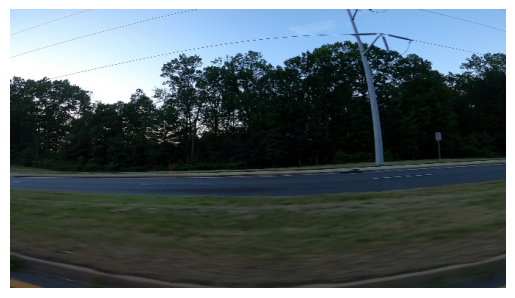

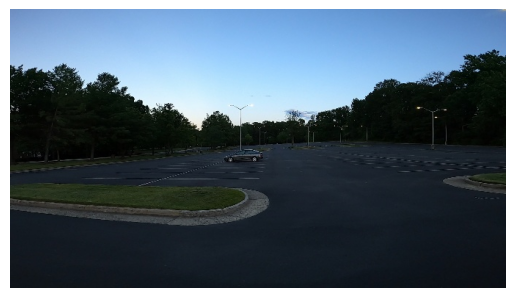

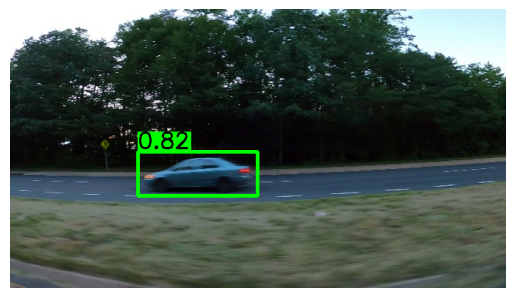

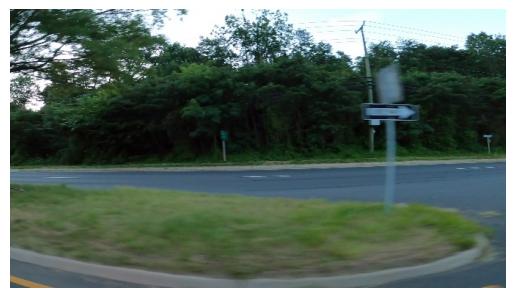

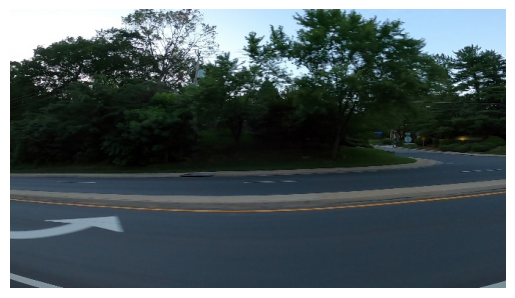

...

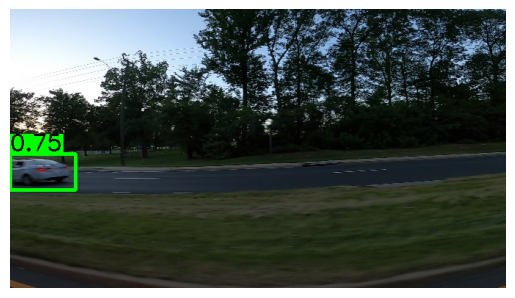

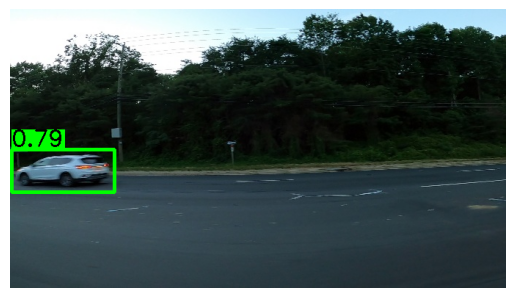

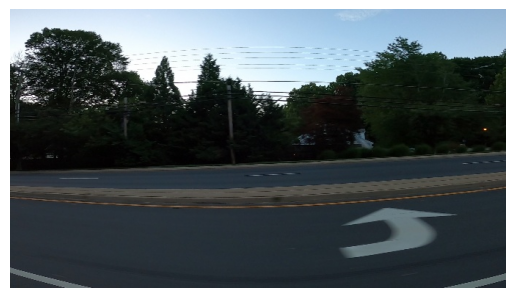

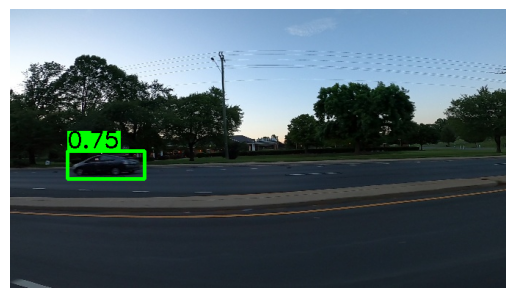

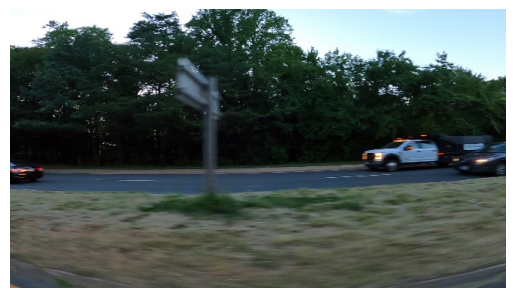

In [ ]:
from ultralytics import YOLO

model_path = 'models/yolov8/detect/train/weights/best.pt'
test_img_dir = '/content/data/testing_images'
conf_thres=0.75
model = YOLO(model_path)
for img_name in os.listdir(test_img_dir):
    img_path = os.path.join(test_img_dir, img_name)

    # Run inference
    results = model(img_path, verbose=False)
    predictions = json.loads(results[0].tojson())
    visualized_img = visualize_bbox(img_path, predictions, conf_thres)

    %matplotlib inline
    plt.imshow(visualized_img)
    plt.axis('off')
    plt.show()